In [1]:
from sys import path
path.append('../src/')

import shap
import numpy as np
import pickle as pkl
import matplotlib.pyplot as plt
import tensorflow as tf
import keras.backend as K
from keras.models import load_model, Model
from global_config import FILE_DUMP_IMAGES, FILE_DUMP_MRKS

%matplotlib inline

Using TensorFlow backend.


In [2]:
FILE_BASE_MODEL = '../models/autoencoders_requirements/merged_model_best_branches.h5'

In [3]:
def map2layer(x, layer_name):
    feed_dict = dict(zip([model.layers[0].input], [x / 255]))
    return K.get_session().run(model.get_layer(layer_name).input, feed_dict)

def shap_explainer(images_to_explain, background_images, model, layer_to_explain, layer_output, zoom_factor=1.0):
    e = shap.GradientExplainer(
        (model.get_layer(layer_to_explain).input, model.get_layer(layer_output).output),
        map2layer(background_images, layer_to_explain),
    )
    shap_values = e.shap_values(map2layer(images_to_explain, layer_to_explain))
    
    shap.image_plot(shap_values, images_to_explain[:, :, :, ::-1], show=False)
    fig_size = plt.gcf().get_size_inches()
    plt.gcf().set_size_inches(fig_size * zoom_factor) 
    plt.show()

# Load Data 

In [4]:
x, image_files = pkl.load(open(FILE_DUMP_IMAGES, 'rb'))
mrks, _ = pkl.load(open(FILE_DUMP_MRKS, 'rb'))

print(x.shape, x.dtype)
print(mrks.shape, mrks.dtype)

(5763, 224, 224, 3) float32
(5763,) object


# Load Model

In [5]:
model = load_model(FILE_BASE_MODEL)
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 224, 224, 16) 448         input[0][0]                      
__________________________________________________________________________________________________
bn_1 (BatchNormalization)       (None, 224, 224, 16) 64          conv_1[0][0]                     
__________________________________________________________________________________________________
relu_1 (Activation)             (None, 224, 224, 16) 0           bn_1[0][0]                       
____________________

No training configuration found in save file: the model was *not* compiled. Compile it manually.


# SHAP 

In [6]:
np.random.seed(42)
random_idxs = np.random.choice(x.shape[0], size=100, replace=False)
background_data = x[random_idxs]

print(background_data.shape)

(100, 224, 224, 3)


## Blurred 

In [7]:
y = np.array([mrk.photo_reqs.blurred.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 905, 4858], dtype=int64))


Instructions for updating:
Use tf.cast instead.


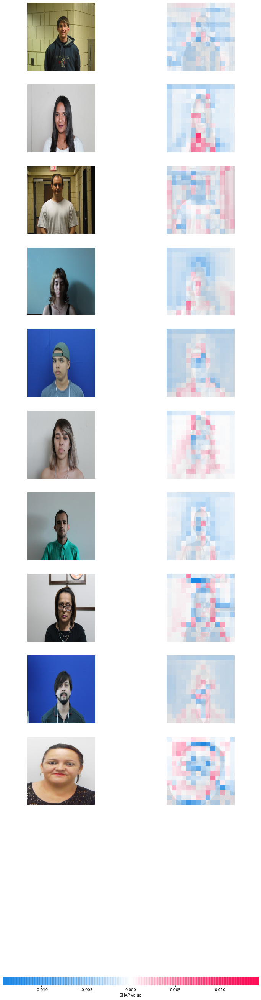

In [8]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'blurred', zoom_factor=2.0)

## Looking Away

In [9]:
y = np.array([mrk.photo_reqs.looking_away.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1817, 3946], dtype=int64))


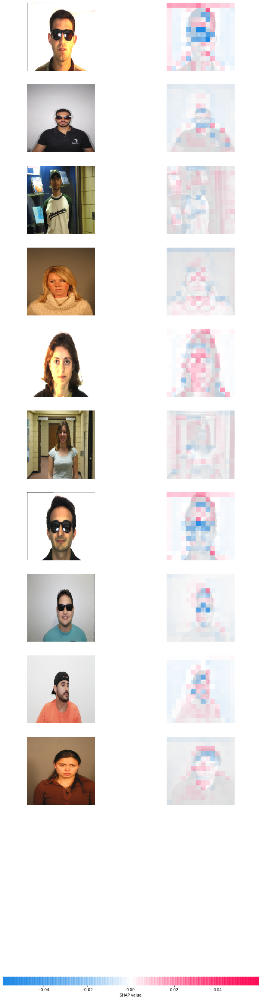

In [10]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'looking_away', zoom_factor=2.0)

## Ink Marked/Creased 

In [11]:
y = np.array([mrk.photo_reqs.ink_marked_creased.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([  21, 5742], dtype=int64))


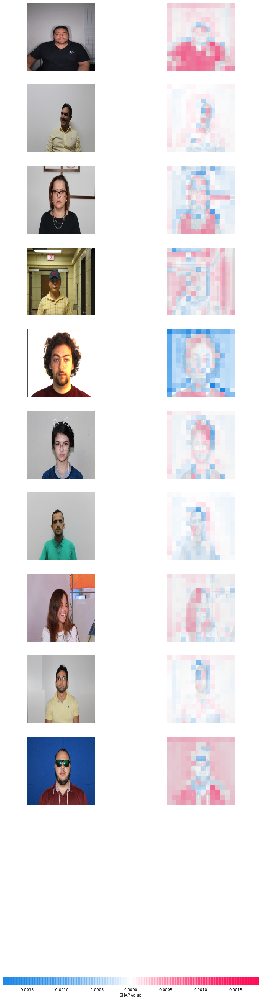

In [12]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'ink_marked_creased', zoom_factor=2.0)

## Unnatural Skin Tone 

In [51]:
y = np.array([mrk.photo_reqs.unnatural_skin_tone.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([3223, 2540], dtype=int64))


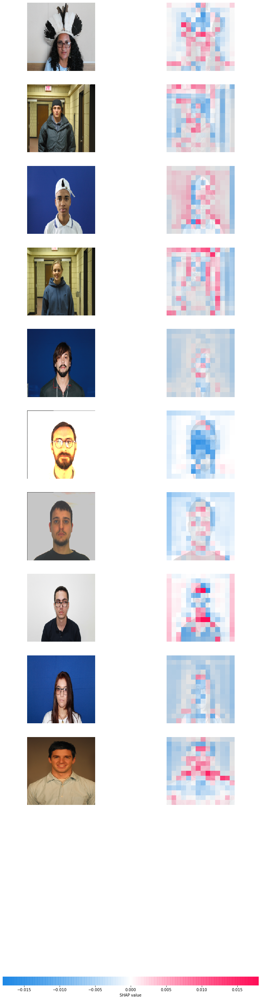

In [53]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'unnatural_skin_tone', zoom_factor=2.0)

## Too Dark/Light 

In [13]:
y = np.array([mrk.photo_reqs.too_dark_light.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 456, 5307], dtype=int64))


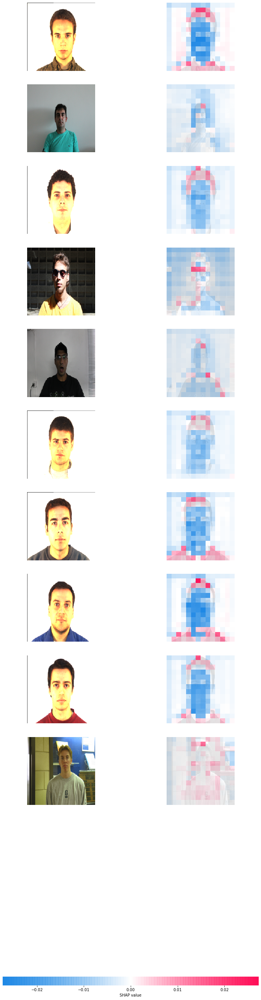

In [14]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'too_dark_light', zoom_factor=2.0)

## Washed Out

In [15]:
y = np.array([mrk.photo_reqs.washed_out.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([  73, 5690], dtype=int64))


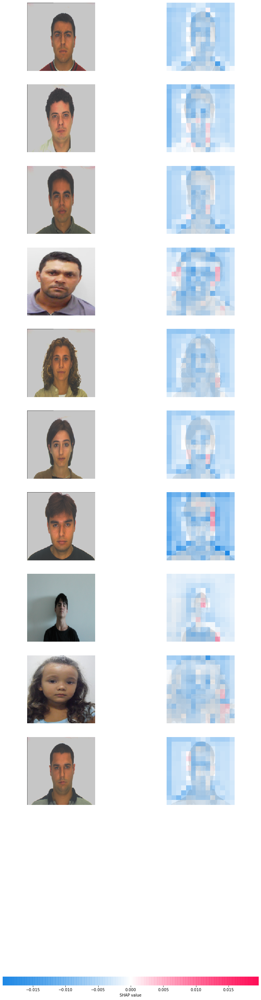

In [16]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'washed_out', zoom_factor=2.0)

## Pixelation

In [17]:
y = np.array([mrk.photo_reqs.pixelation.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 397, 5366], dtype=int64))


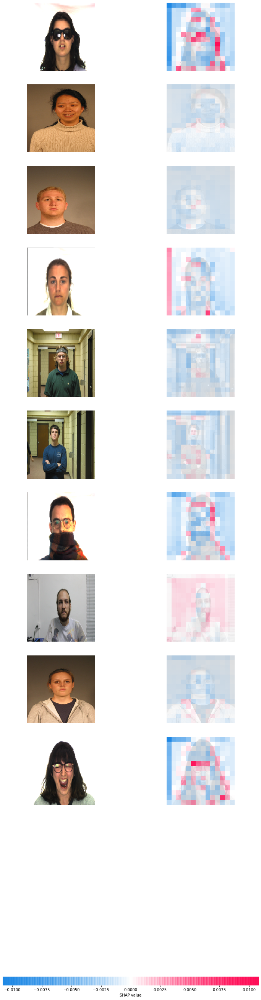

In [18]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'pixelation', zoom_factor=2.0)

## Hair Across Eyes 

In [19]:
y = np.array([mrk.photo_reqs.hair_across_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1511, 4252], dtype=int64))


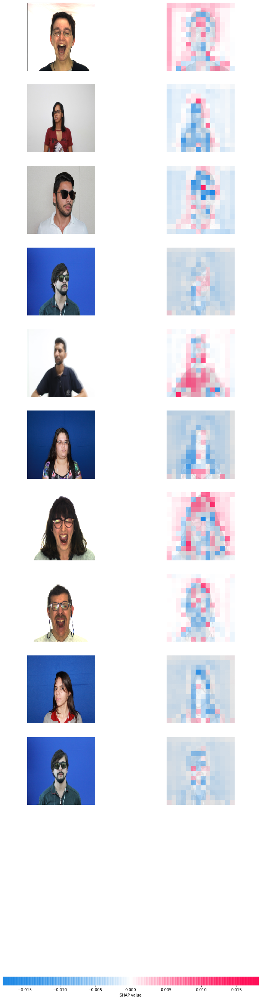

In [20]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'hair_across_eyes', zoom_factor=2.0)

## Eyes Closed 

In [21]:
y = np.array([mrk.photo_reqs.eyes_closed.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1323, 4440], dtype=int64))


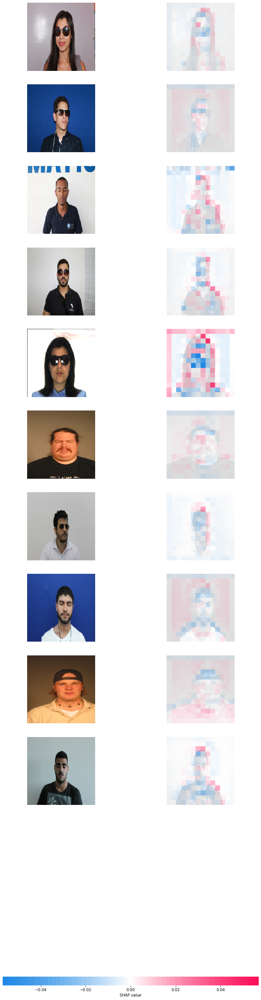

In [22]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'eyes_closed', zoom_factor=2.0)

## Varied Background

In [23]:
y = np.array([mrk.photo_reqs.varied_background.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([2515, 3248], dtype=int64))


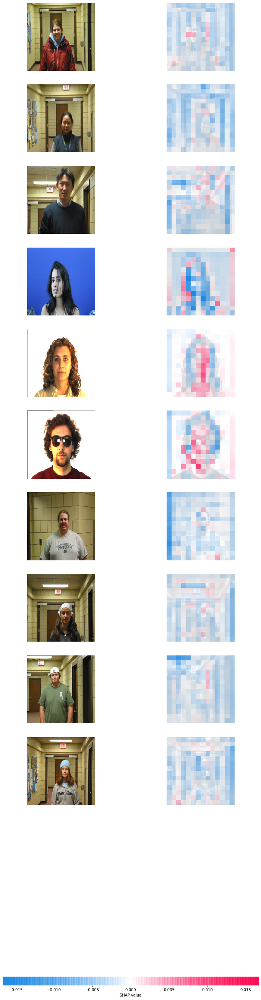

In [24]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'varied_background', zoom_factor=2.0)

## Roll/Pitch/Yaw

In [25]:
y = np.array([mrk.photo_reqs.roll_pitch_yaw.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1416, 4347], dtype=int64))


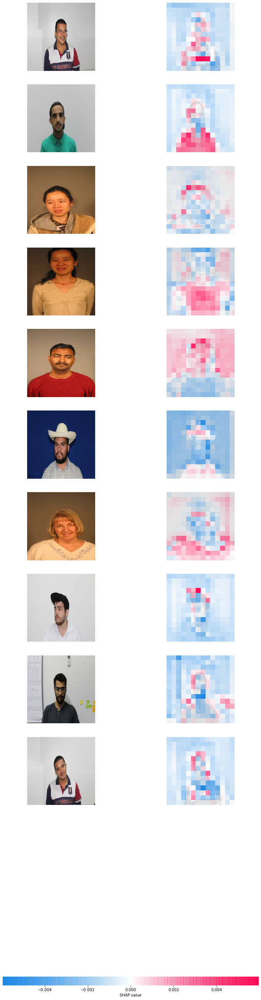

In [26]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'roll_pitch_yaw', zoom_factor=2.0)

## Flash Reflection on Skin 

In [27]:
y = np.array([mrk.photo_reqs.flash_reflection_on_skin.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([2620, 3143], dtype=int64))


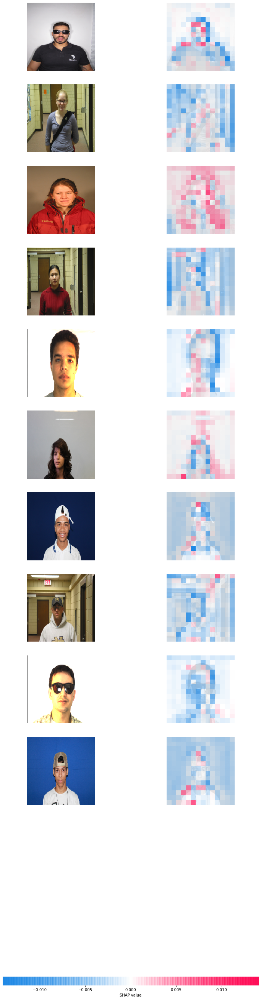

In [28]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'flash_reflection_on_skin', zoom_factor=2.0)

## Red Eyes

In [29]:
y = np.array([mrk.photo_reqs.red_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1232, 4531], dtype=int64))


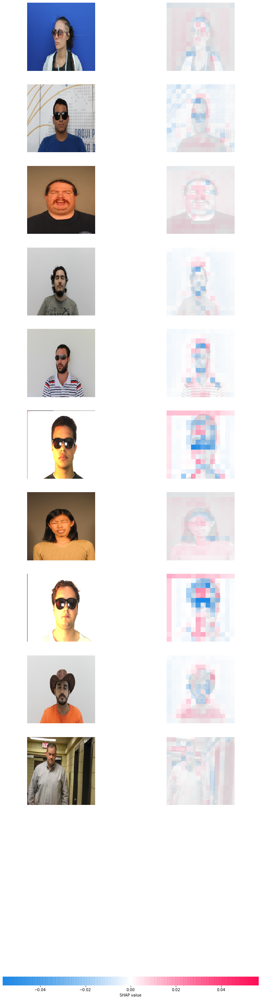

In [30]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'red_eyes', zoom_factor=2.0)

## Shadows Behind Head 

In [31]:
y = np.array([mrk.photo_reqs.shadows_behind_head.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1897, 3866], dtype=int64))


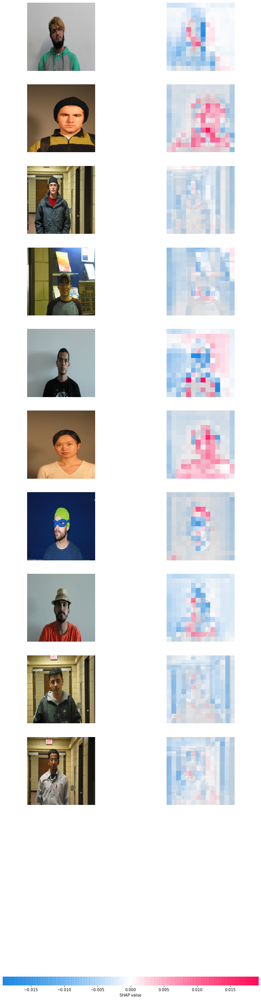

In [32]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'shadows_behind_head', zoom_factor=2.0)

## Shadows Across Face

In [33]:
y = np.array([mrk.photo_reqs.shadows_across_face.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1142, 4621], dtype=int64))


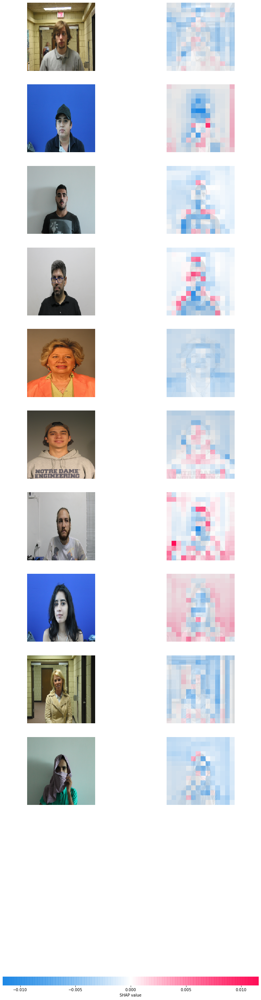

In [34]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'shadows_across_face', zoom_factor=2.0)

## Dark Tinted Lenses 

In [35]:
y = np.array([mrk.photo_reqs.dark_tinted_lenses.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 642, 5121], dtype=int64))


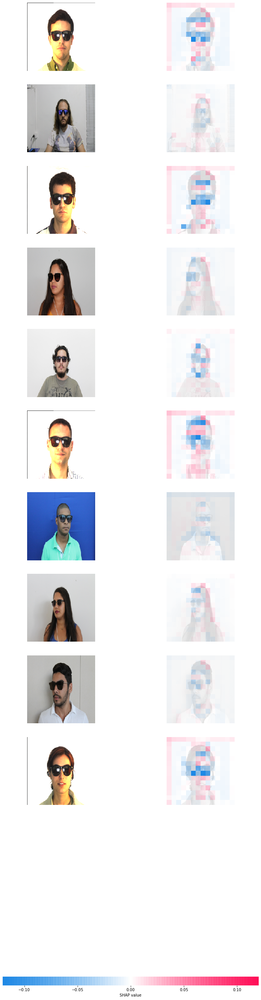

In [36]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'dark_tinted_lenses', zoom_factor=2.0)

## Flash Reflection on Lenses

In [37]:
y = np.array([mrk.photo_reqs.flash_reflection_on_lenses.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1179, 4584], dtype=int64))


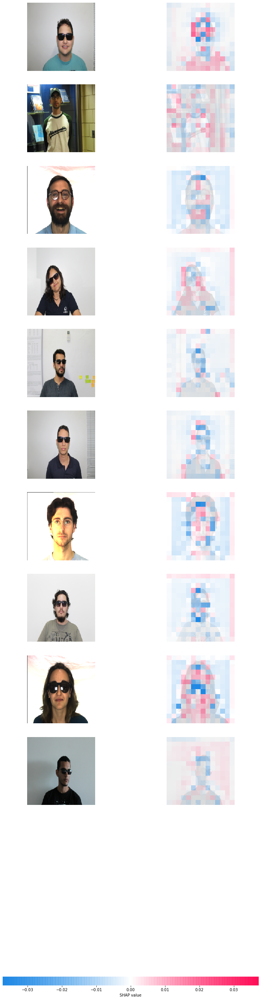

In [38]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'flash_reflection_on_lenses', zoom_factor=2.0)

## Frames Too Heavy

In [39]:
y = np.array([mrk.photo_reqs.frames_too_heavy.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([  17, 5746], dtype=int64))


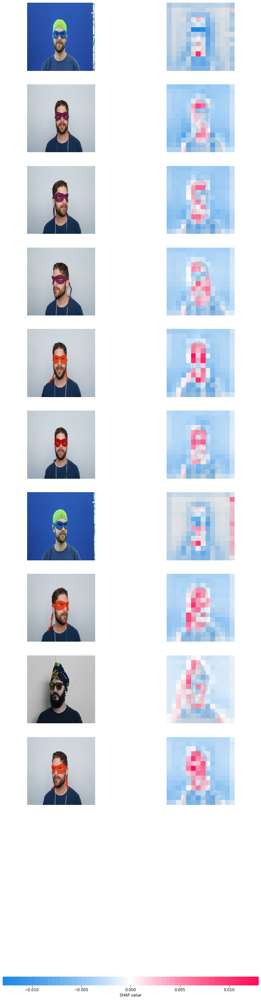

In [40]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'frames_too_heavy', zoom_factor=2.0)

## Frame Covering Eyes

In [41]:
y = np.array([mrk.photo_reqs.frame_covering_eyes.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1679, 4084], dtype=int64))


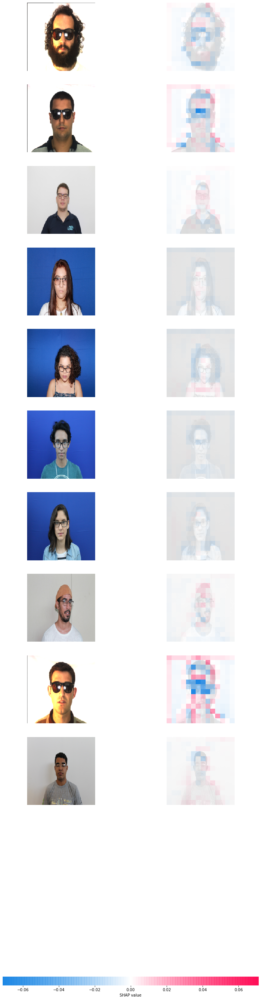

In [42]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'frame_covering_eyes', zoom_factor=2.0)

## Hat/Cap

In [43]:
y = np.array([mrk.photo_reqs.hat_cap.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 849, 4914], dtype=int64))


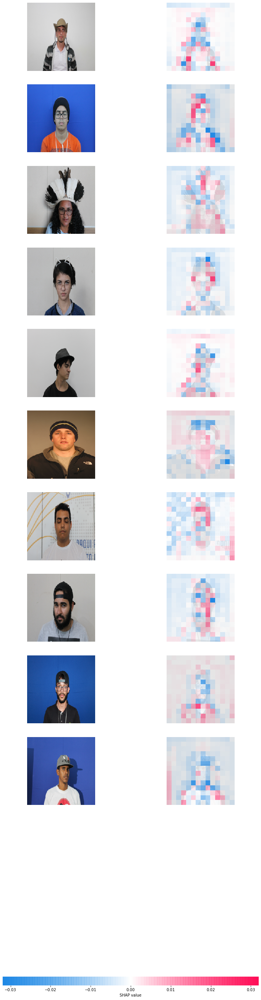

In [44]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'hat_cap', zoom_factor=2.0)

## Veil Over Face

In [45]:
y = np.array([mrk.photo_reqs.veil_over_face.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([ 364, 5399], dtype=int64))


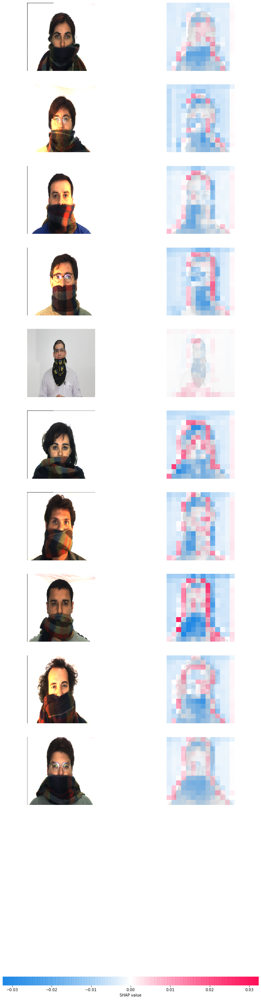

In [46]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'veil_over_face', zoom_factor=2.0)

## Mouth Open

In [47]:
y = np.array([mrk.photo_reqs.mouth_open.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([1532, 4231], dtype=int64))


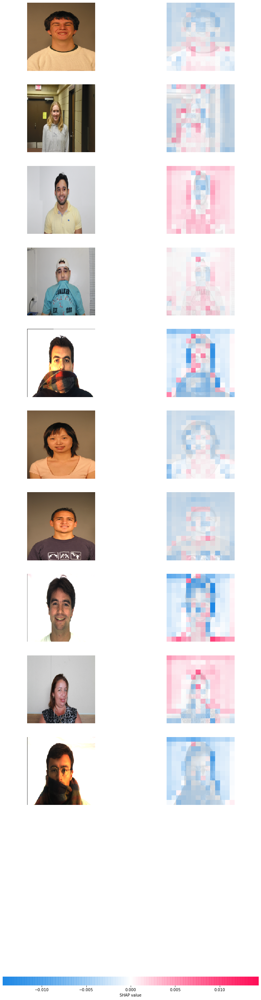

In [48]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'mouth_open', zoom_factor=2.0)

## Presence of Other Faces or Toys

In [49]:
y = np.array([mrk.photo_reqs.presence_of_other_faces_or_toys.value for mrk in mrks])
print(y.shape)
print(np.unique(y, return_counts=True))

(5763,)
(array([0, 1]), array([  70, 5693], dtype=int64))


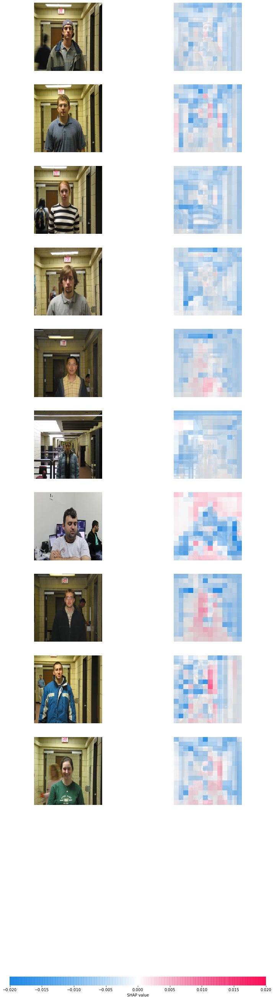

In [50]:
images_nc = x[y == 0]

random_idx = np.random.choice(range(images_nc.shape[0]), size=10, replace=False)
to_explain = images_nc[random_idx]

shap_explainer(to_explain, background_data, model, 'encoded', 'presence_of_other_faces_or_toys', zoom_factor=2.0)